## US Counties: Daily COVID19 cases ,fatalities, daily weather ,socio/econ/health data


In [27]:
img

In this kernel we are trying to show how social, economic and weather data related to Covid-19 transmission.

The dataset  we focused on is in US county level data.

In [3]:
#import all necessary packages
from IPython.display import Image
imgUrl = 'COVID-19.png'            
img = Image(url=imgUrl) 
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as py
import plotly.graph_objects as go
import pandas as pd
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from sklearn.model_selection import train_test_split


In [4]:
#read the data
#https://www.kaggle.com/johnjdavisiv/us-counties-covid19-weather-sociohealth-data
# data from Jan 21 to May 29
data = pd.read_csv("us_counties_covid-19.csv")
data

,date,county,state,fips,cases,deaths,stay_at_home_announced,stay_at_home_effective,lat,lon,...,min_temp_3d_avg,min_temp_5d_avg,min_temp_10d_avg,min_temp_15d_avg,dewpoint_3d_avg,dewpoint_5d_avg,dewpoint_10d_avg,dewpoint_15d_avg,date_stay_at_home_announced,date_stay_at_home_effective
0,2020-01-21,Snohomish,Washington,53061,1,0,no,no,48.047489,-121.697307,...,38.266667,38.92,38.44,36.146667,40.333333,41.64,40.74,37.973333,2020-03-23,2020-03-23
1,2020-01-22,Snohomish,Washington,53061,1,0,no,no,48.047489,-121.697307,...,39.233333,41.12,39.76,37.613333,42.633333,42.98,41.68,39.440000,2020-03-23,2020-03-23
2,2020-01-23,Snohomish,Washington,53061,1,0,no,no,48.047489,-121.697307,...,42.900000,41.74,41.15,38.226667,44.733333,43.72,42.47,40.120000,2020-03-23,2020-03-23
3,2020-01-24,Cook,Illinois,17031,1,0,no,no,41.840039,-87.816716,...,32.366667,30.02,27.43,24.886667,31.433333,28.50,25.00,22.693333,2020-03-20,2020-03-21
4,2020-01-24,Snohomish,Washington,53061,1,0,no,no,48.047489,-121.697307,...,44.600000,42.54,41.75,38.226667,46.000000,44.30,42.88,41.293333,2020-03-23,2020-03-23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
186735,2020-05-29,Sweetwater,Wyoming,56037,26,0,no,no,41.659538,-108.879567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186736,2020-05-29,Teton,Wyoming,56039,100,1,no,no,43.934776,-110.589759,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186737,2020-05-29,Uinta,Wyoming,56041,12,0,no,no,41.287648,-110.547639,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186738,2020-05-29,Washakie,Wyoming,56043,34,3,no,no,43.904970,-107.682819,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# chose 14 variables from the dataset
covid19_data =data[["date","county","state","cases","deaths","total_population","population_density_per_sqmi", "percent_smokers","life_expectancy","median_household_income","percent_age_65_and_older","percent_age_17_and_younger","mean_temp","wind_speed" ]]
covid19_data.head()

,date,county,state,cases,deaths,total_population,population_density_per_sqmi,percent_smokers,life_expectancy,median_household_income,percent_age_65_and_older,percent_age_17_and_younger,mean_temp,wind_speed
0,2020-01-21,Snohomish,Washington,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,44.1,8.3
1,2020-01-22,Snohomish,Washington,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,44.8,13.2
2,2020-01-23,Snohomish,Washington,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,49.9,12.0
3,2020-01-24,Cook,Illinois,1,0,5227575,5531.878539,13.776183,79.415730,63347.0,13.0,22.7,36.1,4.8
4,2020-01-24,Snohomish,Washington,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,51.5,13.0


In [6]:
# get the latest cumulative data (May 29, 2020)
latest_covid_19_data = covid19_data[covid19_data.date =="2020-05-29" ]
latest_covid_19_data.head()

,date,county,state,cases,deaths,total_population,population_density_per_sqmi,percent_smokers,life_expectancy,median_household_income,percent_age_65_and_older,percent_age_17_and_younger,mean_temp,wind_speed
183783,2020-05-29,Autauga,Alabama,212,3,55049,92.605533,18.081557,76.879477,59338.0,14.0,25.2,74.0,0.4
183784,2020-05-29,Baldwin,Alabama,282,9,199510,125.493187,17.489033,78.450258,57588.0,18.7,22.2,NaN,NaN
183785,2020-05-29,Barbour,Alabama,147,1,26614,30.076538,21.999985,75.341935,34382.0,16.5,21.5,76.2,1.1
183786,2020-05-29,Bibb,Alabama,71,1,22572,36.255444,19.114200,73.571820,46064.0,14.9,21.1,70.4,0.4
183787,2020-05-29,Blount,Alabama,60,1,57704,89.490412,19.208672,74.145826,50412.0,17.2,23.6,70.7,2.6


In [5]:
# group by state and sum cases, deaths and total_population
latest_state_data=latest_covid_19_data[["state","cases","deaths","total_population"]].groupby("state").sum()
latest_state_data.head()

,cases,deaths,total_population
state,,,
Alabama,17031,610,4841164
Alaska,435,8,701695
Arizona,18465,885,6728577
Arkansas,6584,132,2963262
California,107043,4144,38645173


In [6]:
# use background gradient to show the each states cases, deaths and total_population
latest_state_data = latest_state_data.sort_values(by='cases', ascending=False)
latest_state_data.style.background_gradient(cmap='Blues',subset=["cases"])\
                        .background_gradient(cmap='Reds',subset=["deaths"])\
                        .background_gradient(cmap='Greens',subset=["total_population"])\

,cases,deaths,total_population
state,,,
New York,373108,29535,19697457
New Jersey,157749,11531,8915456
Illinois,117794,5308,12846515
California,107043,4144,38645173
Massachusetts,95223,6712,6742143
Pennsylvania,75073,5467,12783977
Texas,62062,1645,26903449
Florida,54406,2412,19934451
Michigan,52674,5336,9880451


In [7]:
# cumulative total cases and deaths
total_cases_death =latest_covid_19_data[["cases","deaths"]].sum()
print(total_cases_death)
print(total_cases_death["deaths"]/total_cases_death["cases"] * 100 , "%")

cases     1740787
deaths     102372
dtype: int64
5.880788402027359 %


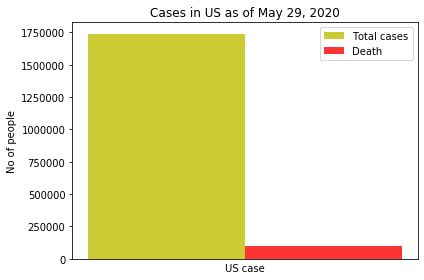

In [8]:
# create bar plot to show the relation between total cases and deaths
fig, ax = plt.subplots()
bar_width = 0.35
opacity = 0.8

rects1 = plt.bar(1, total_cases_death["cases"], bar_width,alpha=opacity,color='y',label='Total cases')

rects2 = plt.bar(1 + bar_width, total_cases_death["deaths"], bar_width,alpha=opacity,color='r',label='Death')

plt.xlabel('US case')
plt.ylabel('No of people')
plt.title('Cases in US as of May 29, 2020')
plt.legend()
plt.xticks([])
plt.tight_layout()
plt.show()

In [9]:
# plot range slider to show the cases and deaths growth over time
init_notebook_mode(connected=True)  
fig = go.Figure()
fig.add_trace(go.Scatter(
                x=covid19_data.date,
                y=covid19_data['cases'],
                name="cases",
                line_color='yellow',
                opacity=0.8))

fig.add_trace(go.Scatter(
                x=covid19_data.date,
                y=covid19_data['deaths'],
                name="deaths",
                line_color='red',
                opacity=0.8))
fig.update_layout(title_text='Time Series with Rangeslider for covid_19 cases and deaths',
                  xaxis_rangeslider_visible=True)
py.offline.iplot(fig)

In [10]:
# cleanining data for scatter plot
#check for null data
covid19_data.isnull().any()

date                           False
county                         False
state                          False
cases                          False
deaths                         False
total_population               False
population_density_per_sqmi    False
percent_smokers                False
life_expectancy                 True
median_household_income        False
percent_age_65_and_older       False
percent_age_17_and_younger     False
mean_temp                       True
wind_speed                      True
dtype: bool

In [11]:
# drop all null rows
covid19_data.dropna(inplace=True)
covid19_data.isnull().any()

C:\Anaconda\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



date                           False
county                         False
state                          False
cases                          False
deaths                         False
total_population               False
population_density_per_sqmi    False
percent_smokers                False
life_expectancy                False
median_household_income        False
percent_age_65_and_older       False
percent_age_17_and_younger     False
mean_temp                      False
wind_speed                     False
dtype: bool

In [12]:
# find the average temperature from Jan 21 to May 29
average_temp=covid19_data[["state","county","mean_temp"]].groupby(["state","county"]).mean()
average_temp=average_temp.rename(columns={'mean_temp': 'average_temp_since_jan21'})
average_temp

average_temp_since_jan21
state   county                              
Alabama Autauga                    67.616418
        Baldwin                    69.523684
        Barbour                    66.712281
        Bibb                       64.813115
        Blount                     60.806061
...                                      ...
Wyoming Sheridan                   43.471250
        Sublette                   38.715873
        Sweetwater                 44.092537
        Uinta                      44.670690
        Washakie                   48.084375

[2810 rows x 1 columns]

In [13]:
# find the average wind speed from Jan 21 to May 29
average_wind_speed = covid19_data[["state","county","wind_speed"]].groupby(["state","county"]).mean()
average_wind_speed=average_wind_speed.rename(columns={'wind_speed': 'average_wind_speed_since_jan21'})
average_wind_speed 

average_wind_speed_since_jan21
state   county                                    
Alabama Autauga                           4.504478
        Baldwin                           4.264474
        Barbour                           3.100000
        Bibb                              3.624590
        Blount                            4.190909
...                                            ...
Wyoming Sheridan                          7.148750
        Sublette                          6.895238
        Sweetwater                       10.544776
        Uinta                             9.384483
        Washakie                          6.193750

[2810 rows x 1 columns]

In [14]:

# group by state and county to eliminate duplicate county names
    
latest_covid_19_data=latest_covid_19_data.groupby(["state","county"]).mean()

# replace the mean_temp and mean_wind_speed of May 29 with the average from Jan 21 to May 29
merege_average_temp =  pd.merge(latest_covid_19_data,average_temp, on=["state",'county'], how='inner')
final_latest_data= pd.merge(merege_average_temp,average_wind_speed, on=["state",'county'], how='inner')
final_latest_data

cases  deaths  total_population  \
state   county                                        
Alabama Autauga       212       3             55049   
        Baldwin       282       9            199510   
        Barbour       147       1             26614   
        Bibb           71       1             22572   
        Blount         60       1             57704   
...                   ...     ...               ...   
Wyoming Sheridan       16       0             29924   
        Sublette        3       0             10032   
        Sweetwater     26       0             44812   
        Uinta          12       0             20893   
        Washakie       34       3              8351   

                    population_density_per_sqmi  percent_smokers  \
state   county                                                     
Alabama Autauga                       92.605533        18.081557   
        Baldwin                      125.493187        17.489033   
        Barbour                       30.076538        21.999985   
        Bibb                          36.255444        19.114200   
        Blount                        89.490412        19.208672   
...                                         ...              ...   
Wyoming Sheridan                      11.858791        15.214185   
        Sublette                       2.053012        13.912994   
        Sweetwater                     4.297803        18.073422   
        Uinta                         10.035892        17.212675   
        Washakie                       3.730539        16.859400   

                    life_expectancy  median_household_income  \
state   county                                                 
Alabama Autauga           76.879477                  59338.0   
        Baldwin           78.450258                  57588.0   
        Barbour           75.341935                  34382.0   
        Bibb              73.571820                  46064.0   
        Blount            74.145826                  50412.0   
...                             ...                      ...   
Wyoming Sheridan          78.237399                  58307.0   
        Sublette          82.851608                  74570.0   
        Sweetwater        77.285778                  73315.0   
        Uinta             79.245997                  63401.0   
        Washakie          79.451504                  55190.0   

                    percent_age_65_and_older  percent_age_17_and_younger  \
state   county                                                             
Alabama Autauga                         14.0                        25.2   
        Baldwin                         18.7                        22.2   
        Barbour                         16.5                        21.5   
        Bibb                            14.9                        21.1   
        Blount                          17.2                        23.6   
...                                      ...                         ...   
Wyoming Sheridan                        18.2                        21.6   
        Sublette                        13.3                        24.1   
        Sweetwater                       9.4                        27.5   
        Uinta                           10.7                        29.6   
        Washakie                        19.7                        24.8   

                    mean_temp  wind_speed  average_temp_since_jan21  \
state   county                                                        
Alabama Autauga          74.0         0.4                 67.616418   
        Baldwin           NaN         NaN                 69.523684   
        Barbour          76.2         1.1                 66.712281   
        Bibb             70.4         0.4                 64.813115   
        Blount           70.7         2.6                 60.806061   
...                       ...         ...                       ...   
Wyoming Sheridan         56.9

In [15]:
# drop the mean_temp and mean_wind speed
final_latest_data.drop([final_latest_data.columns[9] , final_latest_data.columns[10]] ,axis=1,inplace=True)
final_latest_data
# dataset ready for more visualization 

cases  deaths  total_population  \
state   county                                        
Alabama Autauga       212       3             55049   
        Baldwin       282       9            199510   
        Barbour       147       1             26614   
        Bibb           71       1             22572   
        Blount         60       1             57704   
...                   ...     ...               ...   
Wyoming Sheridan       16       0             29924   
        Sublette        3       0             10032   
        Sweetwater     26       0             44812   
        Uinta          12       0             20893   
        Washakie       34       3              8351   

                    population_density_per_sqmi  percent_smokers  \
state   county                                                     
Alabama Autauga                       92.605533        18.081557   
        Baldwin                      125.493187        17.489033   
        Barbour                       30.076538        21.999985   
        Bibb                          36.255444        19.114200   
        Blount                        89.490412        19.208672   
...                                         ...              ...   
Wyoming Sheridan                      11.858791        15.214185   
        Sublette                       2.053012        13.912994   
        Sweetwater                     4.297803        18.073422   
        Uinta                         10.035892        17.212675   
        Washakie                       3.730539        16.859400   

                    life_expectancy  median_household_income  \
state   county                                                 
Alabama Autauga           76.879477                  59338.0   
        Baldwin           78.450258                  57588.0   
        Barbour           75.341935                  34382.0   
        Bibb              73.571820                  46064.0   
        Blount            74.145826                  50412.0   
...                             ...                      ...   
Wyoming Sheridan          78.237399                  58307.0   
        Sublette          82.851608                  74570.0   
        Sweetwater        77.285778                  73315.0   
        Uinta             79.245997                  63401.0   
        Washakie          79.451504                  55190.0   

                    percent_age_65_and_older  percent_age_17_and_younger  \
state   county                                                             
Alabama Autauga                         14.0                        25.2   
        Baldwin                         18.7                        22.2   
        Barbour                         16.5                        21.5   
        Bibb                            14.9                        21.1   
        Blount                          17.2                        23.6   
...                                      ...                         ...   
Wyoming Sheridan                        18.2                        21.6   
        Sublette                        13.3                        24.1   
        Sweetwater                       9.4                        27.5   
        Uinta                           10.7                        29.6   
        Washakie                        19.7                        24.8   

                    average_temp_since_jan21  average_wind_speed_since_jan21  
state   county                                                                
Alabama Autauga                    67.616418                        4.504478  
        Baldwin                    69.523684                        4.264474  
        Barbour                    66.712281                        3.100000  
        Bibb                       64.813115                        3.624590  
        Blount                     60.806061                        4.190909  
...                                      ...

In [16]:
top3_states = ["New York" ,"New Jersey" ,"Illinois" ]
final_latest_data_top3_states =final_latest_data.loc[top3_states]
bottom3_states =["Alaska" ,"Montana" ,"Hawaii" ]
final_latest_data_bottom3_states =final_latest_data.loc[bottom3_states]


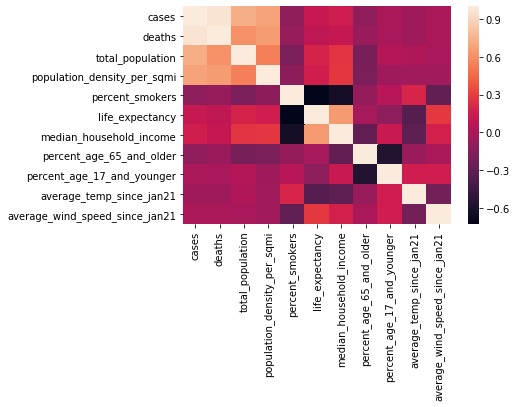

In [17]:
corr=final_latest_data.corr()
sns.heatmap(corr)

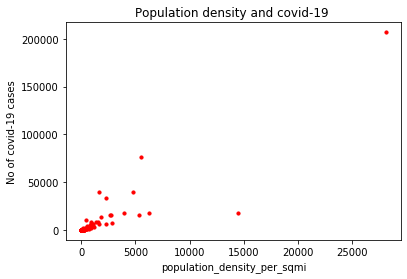

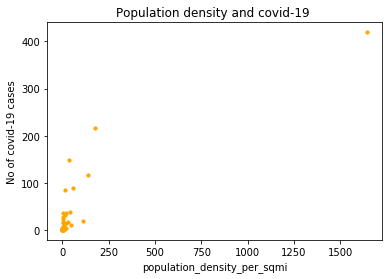

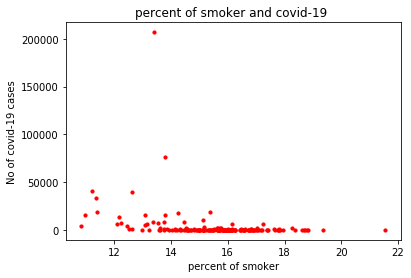

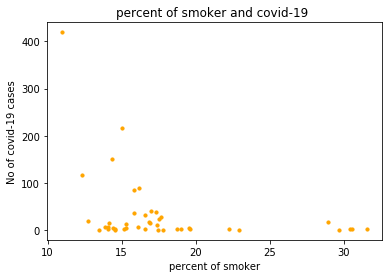

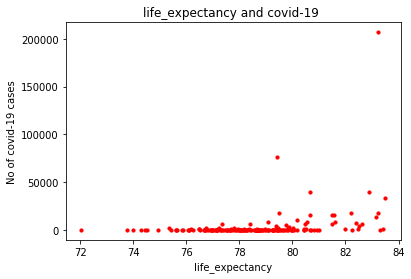

...

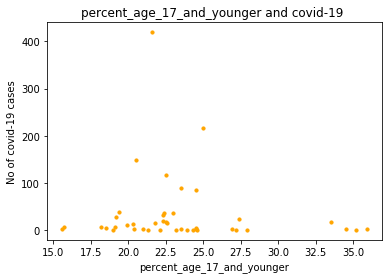

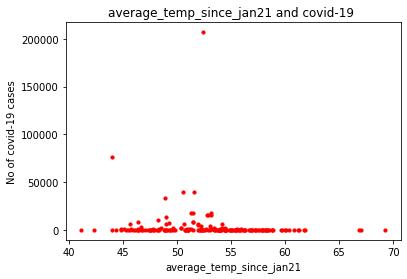

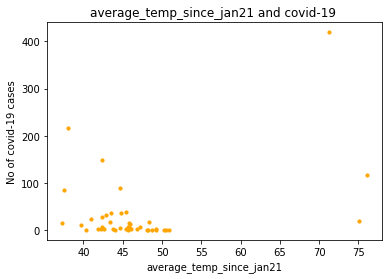

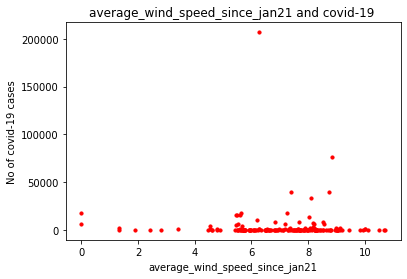

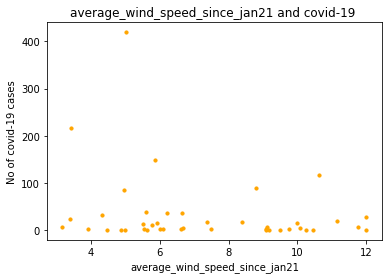

In [18]:
plt.scatter(final_latest_data_top3_states["population_density_per_sqmi"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('Population density and covid-19 ')
plt.xlabel('population_density_per_sqmi')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_bottom3_states["population_density_per_sqmi"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('Population density and covid-19 ')
plt.xlabel('population_density_per_sqmi')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["percent_smokers"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('percent of smoker and covid-19 ')
plt.xlabel('percent of smoker')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_bottom3_states["percent_smokers"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('percent of smoker and covid-19 ')
plt.xlabel('percent of smoker')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["life_expectancy"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('life_expectancy and covid-19 ')
plt.xlabel('life_expectancy')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_bottom3_states["life_expectancy"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('life_expectancy and covid-19 ')
plt.xlabel('life_expectancy')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["median_household_income"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('median_household_income and covid-19 ')
plt.xlabel('median_household_income')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_bottom3_states["median_household_income"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('median_household_income and covid-19 ')
plt.xlabel('median_household_income')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["percent_age_65_and_older"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('percent_age_65_and_older and covid-19 ')
plt.xlabel('percent_age_65_and_older')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_bottom3_states["percent_age_65_and_older"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('percent_age_65_and_older and covid-19 ')
plt.xlabel('percent_age_65_and_older')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["percent_age_17_and_younger"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('percent_age_17_and_younger and covid-19 ')
plt.xlabel('percent_age_17_and_younger')
plt.ylabel('No of covid-19 cases')
plt.show()
plt.scatter(final_latest_data_bottom3_states["percent_age_17_and_younger"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('percent_age_17_and_younger and covid-19 ')
plt.xlabel('percent_age_17_and_younger')
plt.ylabel('No of covid-19 cases')
plt.show()

plt.scatter(final_latest_data_top3_states["average_temp_since_jan21"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('average_temp_since_jan21 and covid-19 ')
plt.xlabel('average_temp_since_jan21')
plt.ylabel('No of covid-19 cases')
plt.show()
plt.scatter(final_latest_data_bottom3_states["average_temp_since_jan21"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('average_temp_since_jan21 and covid-19 ')
plt.xlabel('average_temp_since_jan21')
plt.ylabel('No of covid-19 cases')
plt.show()
plt.scatter(final_latest_data_top3_states["average_wind_speed_since_jan21"], final_latest_data_top3_states["cases"], s=10, c="red", alpha=1)
plt.title('average_wind_speed_since_jan21 and covid-19 ')
plt.xlabel('average_wind_speed_since_jan21')
plt.ylabel('No of covid-19 cases')
plt.show()
plt.scatter(final_latest_data_bottom3_states["average_wind_speed_since_jan21"], final_latest_data_bottom3_states["cases"], s=10, c="orange", alpha=1)
plt.title('average_wind_speed_since_jan21 and covid-19 ')
plt.xlabel('average_wind_speed_since_jan21')
plt.ylabel('No of covid-19 cases')
plt.show()
#https://www.dailymail.co.uk/news/article-8398191/MORE-evidence-smokers-risk-Covid-19-23-likely-catch-virus.html

In [19]:
# Machine Learning 
# check for any categorical variables
covid19_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 176276 entries, 0 to 186738
Data columns (total 14 columns):
date                           176276 non-null object
county                         176276 non-null object
state                          176276 non-null object
cases                          176276 non-null int64
deaths                         176276 non-null int64
total_population               176276 non-null int64
population_density_per_sqmi    176276 non-null float64
percent_smokers                176276 non-null float64
life_expectancy                176276 non-null float64
median_household_income        176276 non-null float64
percent_age_65_and_older       176276 non-null float64
percent_age_17_and_younger     176276 non-null float64
mean_temp                      176276 non-null float64
wind_speed                     176276 non-null float64
dtypes: float64(8), int64(3), object(3)
memory usage: 20.2+ MB


In [20]:
covid19_data.drop([covid19_data.columns[0] , covid19_data.columns[1],covid19_data.columns[2]] ,axis=1,inplace=True)

C:\Anaconda\lib\site-packages\pandas\core\frame.py:4102: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
covid19_data


,cases,deaths,total_population,population_density_per_sqmi,percent_smokers,life_expectancy,median_household_income,percent_age_65_and_older,percent_age_17_and_younger,mean_temp,wind_speed
0,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,44.1,8.3
1,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,44.8,13.2
2,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,49.9,12.0
3,1,0,5227575,5531.878539,13.776183,79.415730,63347.0,13.0,22.7,36.1,4.8
4,1,0,758649,363.586159,12.962309,80.374691,87096.0,12.1,23.2,51.5,13.0
...,...,...,...,...,...,...,...,...,...,...,...
186733,16,0,29924,11.858791,15.214185,78.237399,58307.0,18.2,21.6,56.9,4.6
186734,3,0,10032,2.053012,13.912994,82.851608,74570.0,13.3,24.1,57.4,5.2
186735,26,0,44812,4.297803,18.073422,77.285778,73315.0,9.4,27.5,66.9,5.4
186737,12,0,20893,10.035892,17.212675,79.245997,63401.0,10.7,29.6,64.0,4.9


In [22]:
y = covid19_data["deaths"]
X = covid19_data.drop("deaths", axis=1)


In [23]:
# we split the datset, and specify the size of the test set.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=50)

In [24]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)
print(model.score(X_test, y_test)) 
print ("intercept is: ", model.intercept_)
for i, col in enumerate(X_train.columns):
    print ("coefficient of ", col," is : ",  model.coef_[i])

0.9234881475772662
intercept is:  3.2337346272626277
coefficient of  cases  is :  0.09168423538833226
coefficient of  total_population  is :  -4.977748962370762e-05
coefficient of  population_density_per_sqmi  is :  0.001352320831290904
coefficient of  percent_smokers  is :  -0.2143782205942521
coefficient of  life_expectancy  is :  0.3256162926404537
coefficient of  median_household_income  is :  -0.000680976075130875
coefficient of  percent_age_65_and_older  is :  0.6084947083737037
coefficient of  percent_age_17_and_younger  is :  0.6052285789426652
coefficient of  mean_temp  is :  -0.27458496068480515
coefficient of  wind_speed  is :  -0.21758959058101707


Text(0.5, 1.0, 'Predicted vs. Actual Values ')

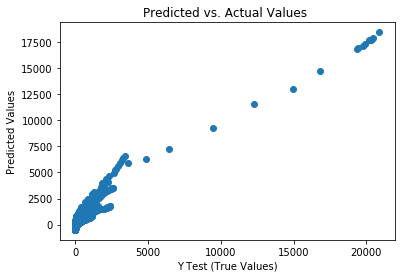

In [25]:
y_pred = model.predict(X_test)
plt.scatter(y_test,y_pred)
plt.xlabel('Y Test (True Values)')
plt.ylabel('Predicted Values')
plt.title('Predicted vs. Actual Values ')

In [26]:
# rmse measures how much the predicted valued is off from the actual vale.
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print("Root Mean Squared Error = ", rmse)
print("The range of deaths = ",y_test.min(),"-" ,y_test.max())

Root Mean Squared Error =  81.58065105898156
The range of deaths =  0 - 20895


Conculusion:

    -varaibles like population density, temprature and percent smoker has high correlation with grwing number of Covud_19 cases
    -The machine learning model can pridict the number of deaths based on all varaible with higher accuracy. 
      This will be very important for preparation to control the crisis of covid_19 in the coming seasons. 